### **Modelo Propuesta: Solar Temporal-Spatial Attention Network (Solar-TSAN)**

**Objetivo**: Crear un modelo específico para el análisis de imágenes solares que integre detección de anomalías, atención espacio-temporal, reducción de dimensionalidad y clustering, para lograr una detección temprana y precisa de eventos solares y su evolución dinámica. Este modelo está diseñado para capturar no solo anomalías puntuales en las imágenes del Sol, sino también los patrones espacio-temporales que podrían indicar la inminencia de fenómenos como las llamaradas solares o eyecciones de masa coronal.

---

### **Nombre del Modelo**: **Solar Temporal-Spatial Attention Network (Solar-TSAN)**

---

### **Arquitectura y Secuencia de Pasos del Modelo Solar-TSAN**

#### **Paso 1: Procesamiento de Imágenes Solares y Preprocesamiento de Anomalías**
1. **Entrada**: Imágenes solares en una secuencia temporal (p. ej., SDO AIA a intervalos de 12 segundos).
2. **Detección de Anomalías Inicial con Isolation Forest**: 
   - Usar Isolation Forest para una detección preliminar de anomalías en cada cuadro.
   - Generar etiquetas de anomalías que indiquen "normal" o "anómalo".
3. **Extracción de Gradientes Espaciales (Sobel) y Temporales**: 
   - Calcular gradientes espaciales en X y Y para capturar cambios en la intensidad de los píxeles.
   - Agregar gradientes temporales entre cuadros para capturar variaciones de intensidad en el tiempo.

#### **Paso 2: Módulo de Atención Espacio-Temporal (TS-Attention)**
1. **Atención Espacial**:
   - Crear un módulo de atención que observe los gradientes y las etiquetas de anomalías generadas.
   - Este módulo destaca regiones con alta concentración de anomalías, ajustando el enfoque del modelo en áreas de interés en cada cuadro.
2. **Atención Temporal**:
   - Implementar atención temporal que analiza la evolución de los gradientes y anomalías entre cuadros consecutivos, enfatizando áreas de cambio constante o acelerado.
3. **Mapa de Anomalías Espacio-Temporal**:
   - Generar un mapa de atención espacio-temporal que identifique áreas críticas en función de la evolución de las anomalías y los gradientes. Este mapa es el núcleo del modelo, pues captura no solo la posición de las anomalías sino también su dinámica a lo largo del tiempo.

#### **Paso 3: Reducción de Dimensionalidad con ceVAE (Contextual Embedding Variational Autoencoder)**
1. **Codificación de Embeddings de Anomalías**:
   - Usar ceVAE para crear embeddings compactos de las anomalías, integrando los mapas de atención espacio-temporal en el espacio latente.
2. **Compresión de Información Espacio-Temporal**:
   - Los embeddings representan no solo la ubicación de la anomalía sino también su evolución temporal, generando una representación que preserva tanto la información espacial como temporal en un espacio reducido.

#### **Paso 4: Clustering No Supervisado (Mean Shift o DBSCAN) en el Espacio Latente**
preferiblemente en mi caso  mean Shift
1. **Clustering de Anomalías**:
   - Aplicar un algoritmo de clustering como Mean Shift o DBSCAN en los embeddings para agrupar anomalías en función de sus características espacio-temporales.
2. **Detección de Grupos Críticos**:
   - Identificar grupos de anomalías que correspondan a regiones activas o precursoras de eventos solares importantes. Esta agrupación permite observar patrones de comportamiento colectivo en las anomalías.

#### **Paso 5: Detección de Bordes con Filtro de Canny en Clústeres Críticos**
1. **Aplicación de Filtro de Canny en Grupos de Anomalías**:
   - Dentro de cada clúster identificado, aplicar el filtro de Canny para delinear los bordes de las estructuras anómalas.
2. **Detección Precisa de Fronteras de Anomalías**:
   - Este paso permite una visualización y análisis de las estructuras internas en áreas de alto riesgo, capturando la forma y los límites de las regiones anómalas.

---

### **Características Clave del Modelo Solar-TSAN**

- **Atención Dirigida**: El modelo adapta su enfoque a regiones de interés, maximizando la precisión en áreas críticas y permitiendo una interpretación visual clara.
- **Embeddings de Anomalías Complejas**: Al integrar gradientes y mapas de atención, el modelo preserva el contexto espacio-temporal de las anomalías.
- **Reducción de Dimensionalidad y Clustering Dinámico**: Con ceVAE y algoritmos de clustering, el modelo comprime y agrupa las anomalías de manera que refleja patrones dinámicos y permite la detección de grupos de alto riesgo.
- **Análisis de Fronteras para Interpretación Visual**: La aplicación del filtro de Canny en clústeres mejora la interpretación al delinear los bordes y estructuras de las anomalías.

---

### **Innovación y Potencial del Modelo Solar-TSAN**

Solar-TSAN integra módulos avanzados de atención espacio-temporal con embeddings de autoencoder variacional, clustering y detección de bordes, todo en una secuencia que optimiza el análisis de imágenes solares para la detección de eventos dinámicos. Este modelo permite:
- Captura dinámica de patrones anómalos en tiempo real, con potencial para predecir eventos solares basándose en la progresión de las anomalías.
- Análisis espacial y temporal unificado, lo que maximiza la sensibilidad y especificidad en la detección de fenómenos complejos.
- Interpretación intuitiva y visual, proporcionando a los investigadores y profesionales en meteorología espacial una herramienta robusta para monitorear y comprender la actividad solar.


#### ** 1: Procesamiento de Imágenes Solares y Preprocesamiento de Anomalías**
1. **Entrada**: Imágenes solares en una secuencia temporal (p. ej., SDO AIA a intervalos de 12 segundos).
2. **Detección de Anomalías Inicial con Isolation Forest**: 
   - Usar Isolation Forest para una detección preliminar de anomalías en cada cuadro.
   - Generar etiquetas de anomalías que indiquen "normal" o "anómalo".
3. **Extracción de Gradientes Espaciales (Sobel) y Temporales**: 
   - Calcular gradientes espaciales en X y Y para capturar cambios en la intensidad de los píxeles.
   - Agregar gradientes temporales entre cuadros para capturar variaciones de intensidad en el tiempo.

In [ ]:
from astropy.visualization.wcsaxes import WCSAxes
from sklearn.ensemble import IsolationForest
from sklearn.preprocessing import StandardScaler
from scipy.ndimage import sobel
import numpy as np
import matplotlib.pyplot as plt
import os
import sunpy.map
import numpy as np
import matplotlib.pyplot as plt
from sklearn.ensemble import IsolationForest
from sklearn.preprocessing import StandardScaler
from scipy.ndimage import sobel
from datetime import datetime, timedelta
from sklearn.model_selection import RandomizedSearchCV

In [ ]:
# Parámetros para el intervalo de tiempo
start_time = "2017-09-10T14:30:00"
end_time = "2017-09-10T17:30:00"
interval_seconds = 12  # Intervalo de tiempo entre imágenes en segundos
data_path = "../Data/SDO_data"

# Convertir cadenas de tiempo a objetos datetime
current_time = datetime.strptime(start_time, "%Y-%m-%dT%H:%M:%S")
end_time = datetime.strptime(end_time, "%Y-%m-%dT%H:%M:%S")

# Inicializar la lista de archivos .fits
fits_files = []

# Verificar si la carpeta existe y listar los archivos .fits
if os.path.exists(data_path):
    fits_files = sorted([f for f in os.listdir(data_path) if f.endswith('.fits')])
    print(f"Archivos .fits encontrados: {len(fits_files)}")
else:
    print(f"La ruta {data_path} no existe.")

In [ ]:
# Funciones de procesamiento
def process_region_of_interest(solar_map, x_start=3380, y_start=1550, region_size=400):
    region_img = solar_map.data[y_start:y_start + region_size, x_start:x_start + region_size]
    return region_img


In [ ]:
# Preprocesamiento de los datos de intensidad (normalización)
scaler = StandardScaler()
intensity_region_scaled = scaler.fit_transform(region_img.reshape(-1, 1))

# Definir el rango de parámetros para RandomizedSearchCV
param_dist = {
    'n_estimators': [50, 100, 150],
    'max_samples': [100, 'auto', 0.75],
    'contamination': [0.05, 0.1, 0.2],
    'max_features': [1.0, 0.5],
}
iso_forest = IsolationForest(random_state=42)

def custom_score(estimator, X):
    scores = estimator.score_samples(X)
    return np.mean(scores)

random_search = RandomizedSearchCV(estimator=iso_forest, param_distributions=param_dist, 
                                   n_iter=10, cv=5, verbose=1, n_jobs=-1,
                                   scoring=custom_score)
random_search.fit(intensity_region_scaled)
print(f"Mejores parámetros: {random_search.best_params_}")


In [ ]:

def detect_anomalies(region_img):
    scaler = StandardScaler()
    intensity_region_scaled = scaler.fit_transform(region_img.reshape(-1, 1))
    iso_forest = IsolationForest(n_estimators=150, max_samples=0.75, max_features=0.5, contamination=0.05, random_state=42)
    iso_forest.fit(intensity_region_scaled)
    anomaly_labels = iso_forest.predict(intensity_region_scaled)
    return anomaly_labels.reshape(region_img.shape)

Archivos .fits encontrados: 900


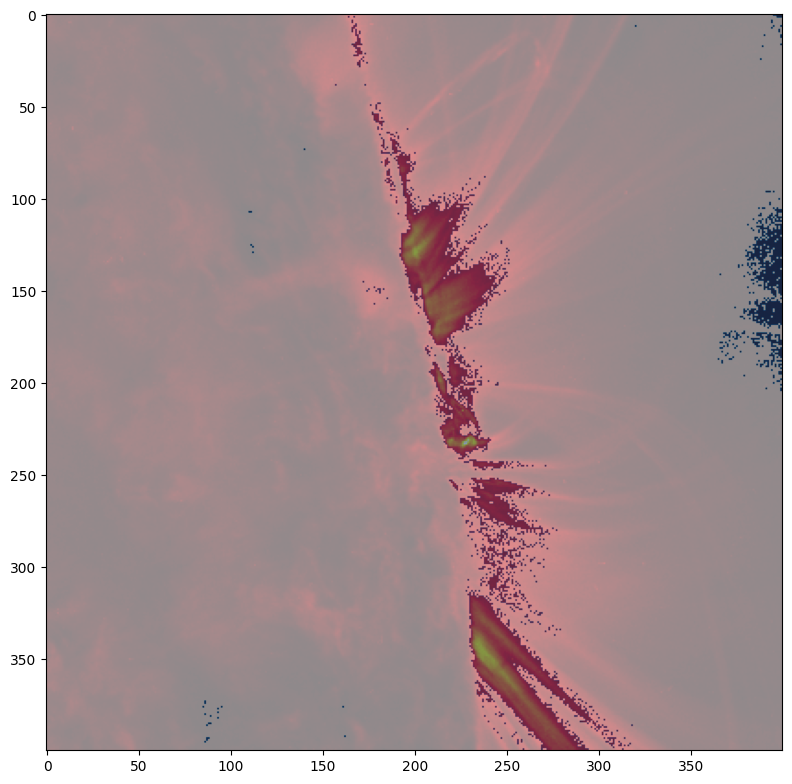

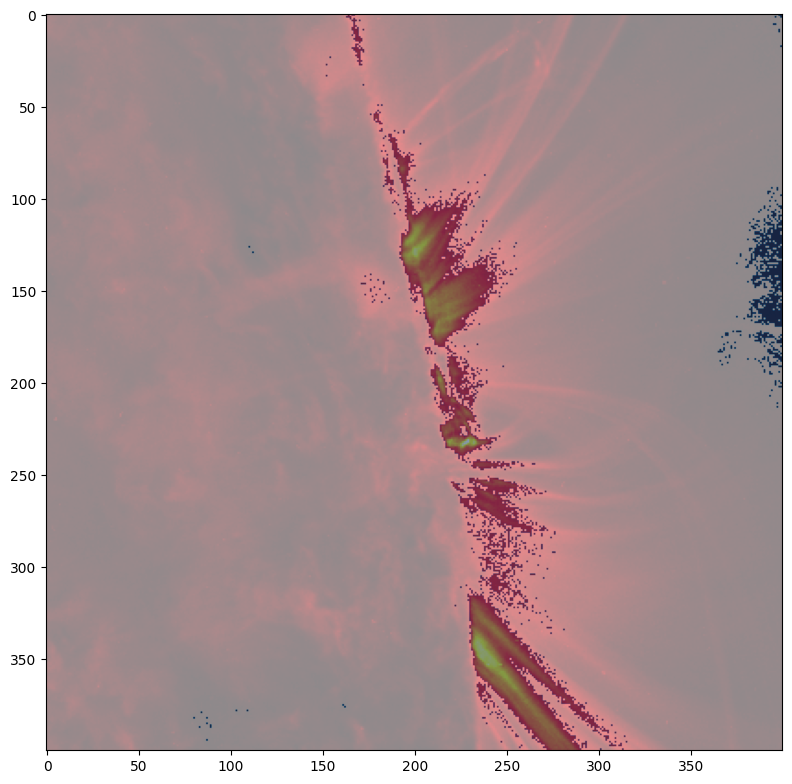

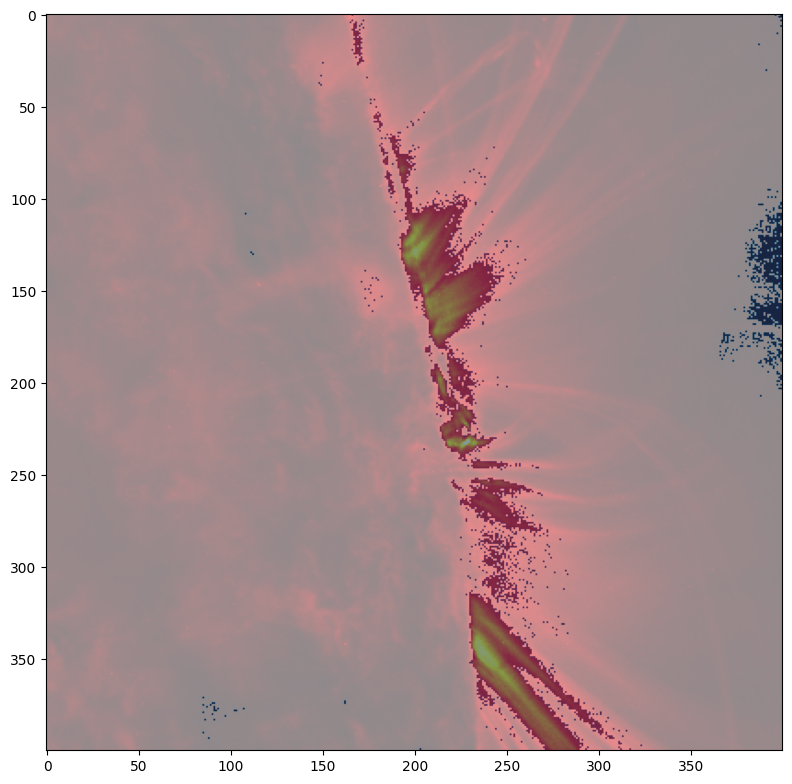

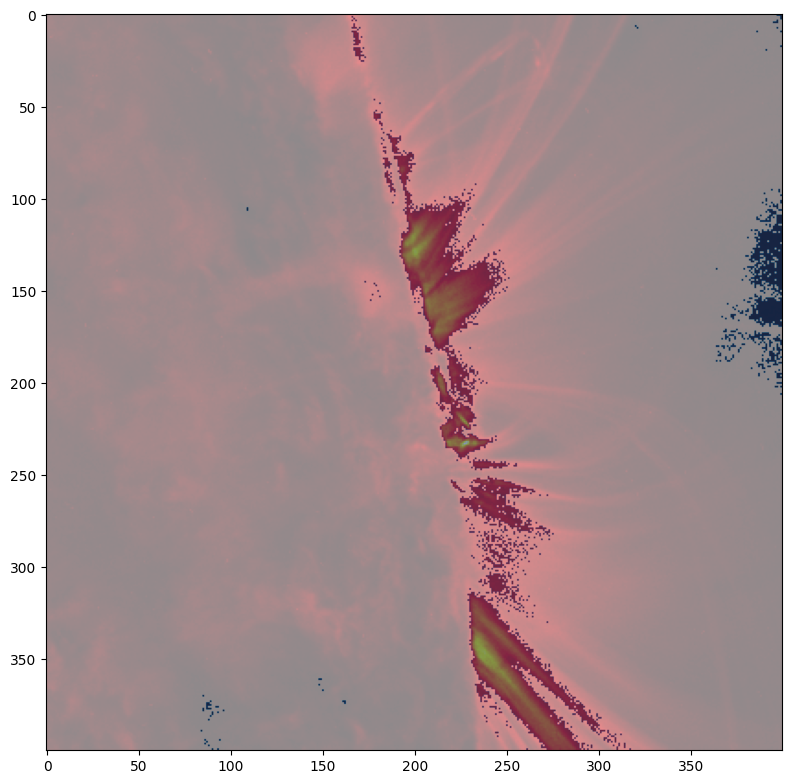

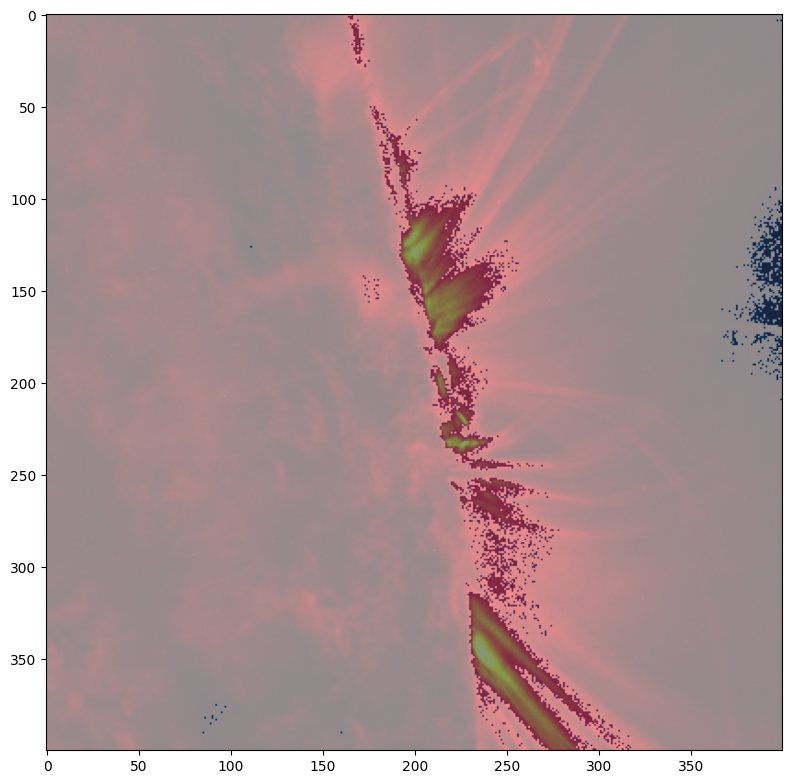

...

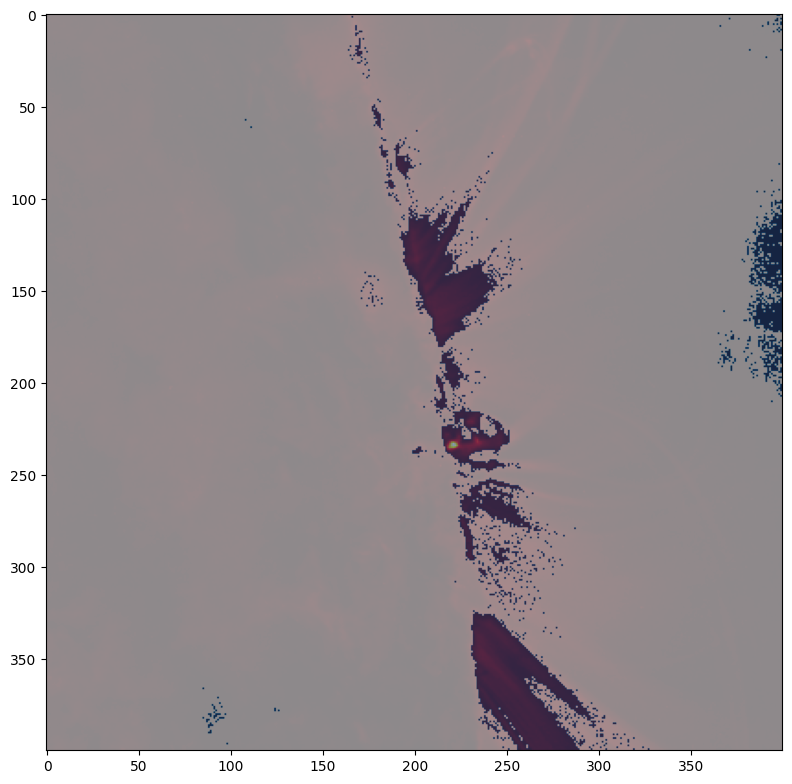

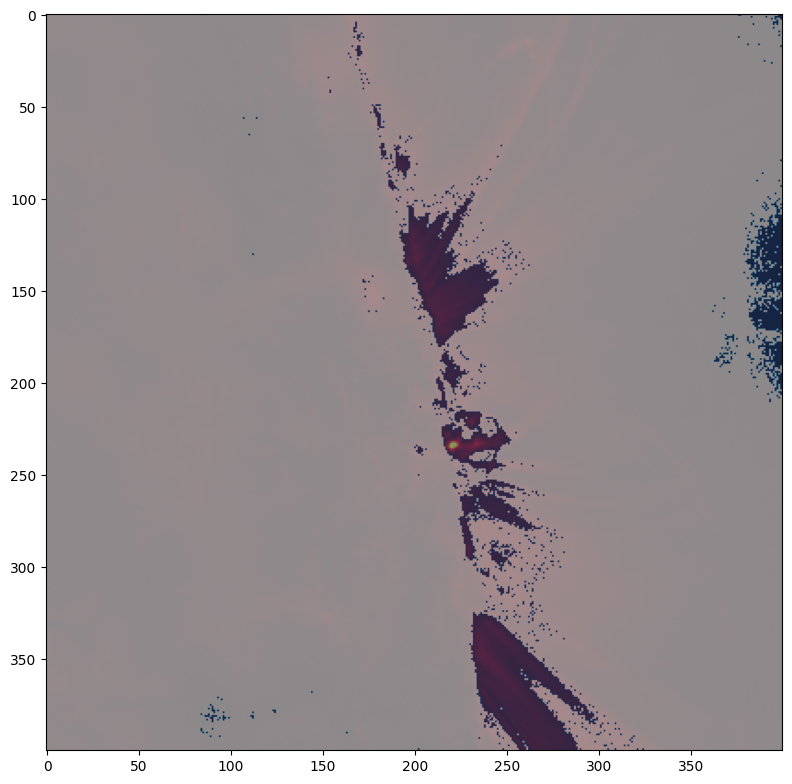

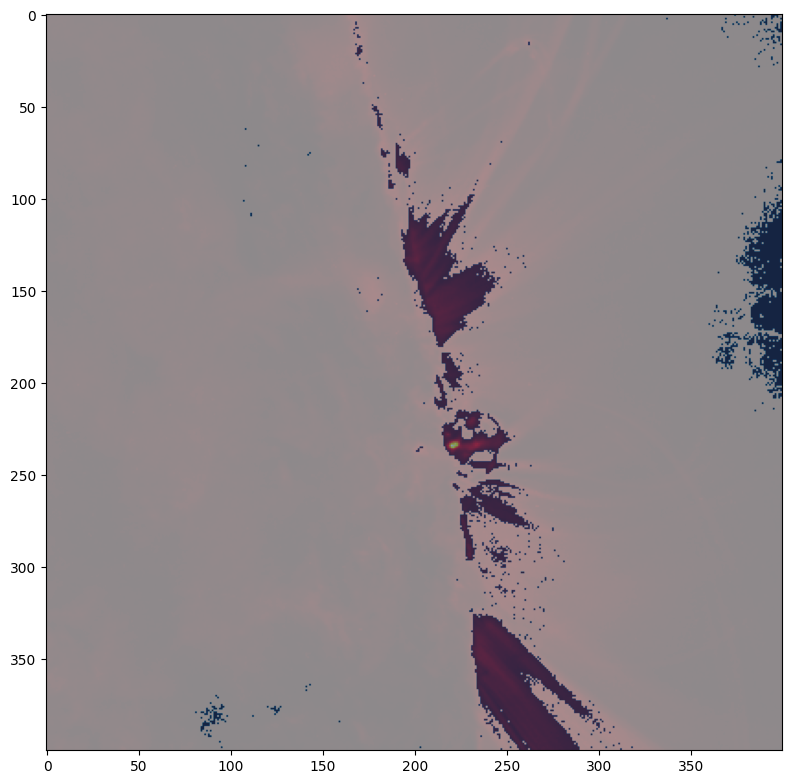

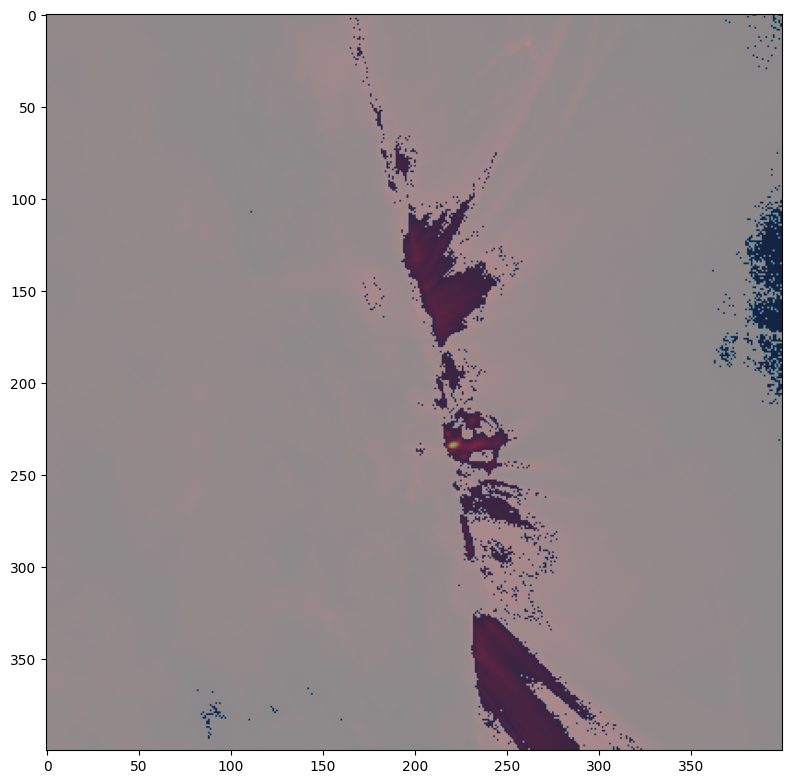

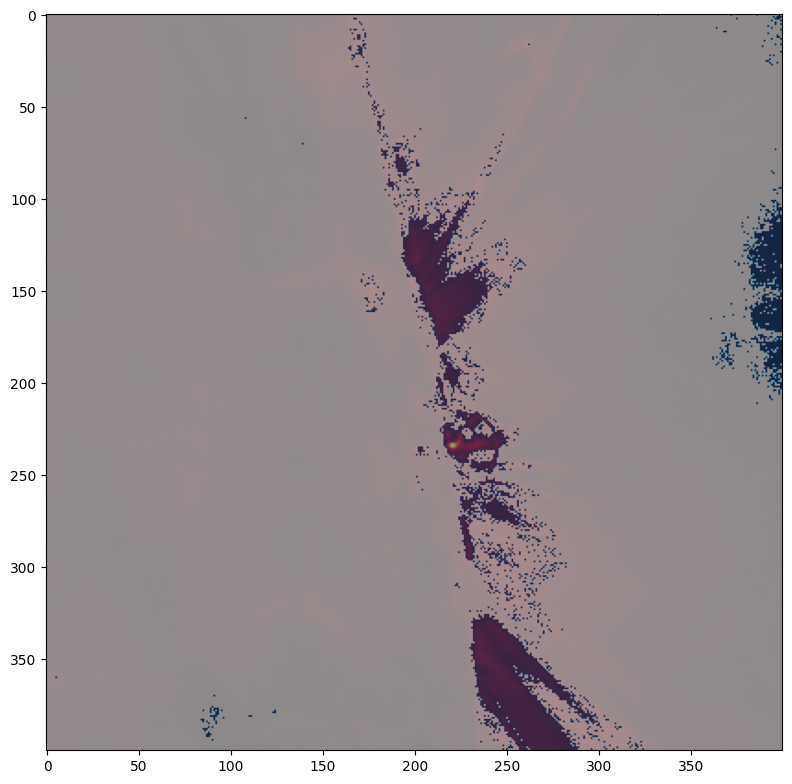

KeyboardInterrupt: 

In [10]:


def extract_gradients(region_img):
    grad_x = sobel(region_img, axis=1)
    grad_y = sobel(region_img, axis=0)
    return grad_x, grad_y

def integrate_features(region_img, grad_x, grad_y):
    scaler = StandardScaler()
    intensity_region_scaled = scaler.fit_transform(region_img.reshape(-1, 1))
    grad_x_scaled = scaler.fit_transform(grad_x.reshape(-1, 1))
    grad_y_scaled = scaler.fit_transform(grad_y.reshape(-1, 1))
    features = np.hstack([intensity_region_scaled, grad_x_scaled, grad_y_scaled])
    return features

def plot_anomalies(region_img, anomaly_labels):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.imshow(region_img, cmap='hot', origin='lower', alpha=0.9)
    ax.imshow(anomaly_labels == -1, cmap='Blues', alpha=0.5)
    plt.tight_layout()
    plt.show()

def process_image(solar_map, file_name):
    region_img = process_region_of_interest(solar_map)
    anomaly_labels = detect_anomalies(region_img)
    grad_x, grad_y = extract_gradients(region_img)
    features = integrate_features(region_img, grad_x, grad_y)
    plot_anomalies(region_img, anomaly_labels)  # Opcional: para visualizar cada imagen procesada
    return features, anomaly_labels

# Procesar cada archivo .fits en el directorio
if fits_files:
    for fits_file in fits_files:
        fits_path = os.path.join(data_path, fits_file)
        
        try:
            # Cargar la imagen FITS y procesarla
            solar_map = sunpy.map.Map(fits_path)
            features, anomaly_labels = process_image(solar_map, fits_file)
            
            # Aquí puedes guardar los `features` y `anomaly_labels` para análisis posterior si es necesario
            
            # Liberar el mapa solar para reducir el uso de memoria
            del solar_map
        
        except Exception as e:
            print(f"Error al procesar {fits_file}: {e}")
else:
    print("No se encontraron archivos .fits.")


In [ ]:
# Definir región de interés
def process_region_of_interest(solar_map, x_start=3380, y_start=1550, region_size=400):
    # Extraer la región activa
    region = solar_map.data[y_start:y_start + region_size, x_start:x_start + region_size]
    return region

# Visualización de imágenes<z
def plot_images(solar_map, region_img, specific_time):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
    ax1 = fig.add_subplot(1, 2, 1, projection=solar_map.wcs)
    solar_map.plot(axes=ax1, title=f"SDO AIA Image at {specific_time}")
    ax2.imshow(region_img, cmap='hot', origin='lower')
    plt.tight_layout()
    plt.show()


In [ ]:
# Definir región de interés
def process_region_of_interest(solar_map, x_start=3380, y_start=1550, region_size=400):
    # Extraer la región activa
    region = solar_map.data[y_start:y_start + region_size, x_start:x_start + region_size]
    return region

# Visualización de imágenes
def plot_images(solar_map, region_img, specific_time):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
    ax1 = fig.add_subplot(1, 2, 1, projection=solar_map.wcs)
    solar_map.plot(axes=ax1, title=f"SDO AIA Image at {specific_time}")
    ax2.imshow(region_img, cmap='hot', origin='lower')
    plt.tight_layout()
    plt.show()

# Detección de anomalías con Isolation Forest
def detect_anomalies(region_img):
    scaler = StandardScaler()
    intensity_region_scaled = scaler.fit_transform(region_img.reshape(-1, 1))
    iso_forest = IsolationForest(n_estimators=150, max_samples=0.75, max_features=0.5, contamination=0.05, random_state=42)
    iso_forest.fit(intensity_region_scaled)
    anomaly_labels = iso_forest.predict(intensity_region_scaled)
    return anomaly_labels.reshape(region_img.shape)

# Extracción de gradientes
def extract_gradients(region_img):
    grad_x = sobel(region_img, axis=1)
    grad_y = sobel(region_img, axis=0)
    return grad_x, grad_y

# Visualizar anomalías
def plot_anomalies(region_img, anomaly_labels):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.imshow(region_img, cmap='hot', origin='lower', alpha=0.9)
    ax.imshow(anomaly_labels == -1, cmap='Blues', alpha=0.5)
    plt.tight_layout()
    plt.show()

# Integración de gradientes como características
def integrate_features(intensity_region_scaled, grad_x, grad_y):
    grad_x_scaled = scaler.fit_transform(grad_x.reshape(-1, 1))
    grad_y_scaled = scaler.fit_transform(grad_y.reshape(-1, 1))
    features = np.hstack([intensity_region_scaled, grad_x_scaled, grad_y_scaled])
    return features

# Ejecución principal
region_img = process_region_of_interest(solar_map)
plot_images(solar_map, region_img, specific_time)
anomaly_labels = detect_anomalies(region_img)
grad_x, grad_y = extract_gradients(region_img)
features = integrate_features(intensity_region_scaled, grad_x, grad_y)
plot_anomalies(region_img, anomaly_labels)
